# Data Analysis of Non-Criminal Traffic Violations in Baltimore City 

## Joel Wheatley

This project attempts to determine the effectiveness of Baltimore City traffic enforcement fines as a source of revenue for the city, and what can be done to more effectively collect on owed payments. This data only includes non-criminal offenses, so infractions like speeding tickets given by a police officer are not included, as that information is not public.

Data was collected from the Baltimore city open data web site, and spans the time period of January 1 2020 through April 14, 2025.

Due to the scope and limit of this project, some data cleaning was done to get to an acceptable base, but the occasional outlier may occcur. This should not undermine the legitmacy of the underlying data, just the ability of human agents to properly record edge cases.

While many pieces of the data set were pulled from online sources, some, like connecting addresses to geocodes (latitude/longitude) were run on a script outside of this progam, and can be provided upon request. Because of the size and scope of cleaning and processing this data, that was done in standard python on a private machine. 

Similarly, because of issues getting geopandas to work on the databricks servers, all graphs and images that were overlayed on a map were generated based on data aggregated in this notebook, then exported to run in a jupyter notebook. Any graphs that were able to be created in databricks were.

In [ ]:
spark.sql("CREATE DATABASE infraction_database")
spark.sql("USE infraction_database")

Out[1]: DataFrame[]

# Import the Main Files

In [ ]:

csv_file='/FileStore/tables/Finance_Parking_Fines_2020_2025-2.csv'
address_csv = '/FileStore/tables/Baltimore_Address_Geocode.csv'

#spark.sql("""DROP TABLE camera_information_table""")
spark.sql("""CREATE TABLE camera_information_table
USING csv OPTIONS (PATH '/FileStore/tables/Finance_Parking_Fines_2020_2025-2.csv')""")

#spark.sql("""CREATE TABLE camera_information_table
#USING csv OPTIONS (PATH address_csv)""")

Out[2]: DataFrame[]

In [ ]:
from matplotlib import pyplot as plt
import pandas as pd

## Establish Schema

In [ ]:
from pyspark.sql.types import StructType, StructField, DoubleType, IntegerType, StringType, DateType, TimestampType

inputSchema = StructType([
    StructField("Citation", StringType(), True),
    StructField("Tag", StringType(), True),
    StructField("ExpMM", StringType(), True),
    StructField("ExpYY", StringType(), True),
    StructField("State", StringType(), True),
    StructField("Make", StringType(), True),
    StructField("Address", StringType(), True),
    StructField("ViolCode", StringType(), True),
    StructField("Description", StringType(), True),
    StructField("ViolFine", IntegerType(), True),
    StructField("ViolDate", StringType(), True),
    StructField("Balance", IntegerType(), True),
    StructField("PenaltyDate", StringType(), True),
    StructField("OpenFine", IntegerType(), True),
    StructField("OpenPenalty", IntegerType(), True),
    StructField("NoticeDate", StringType(), True),
    StructField("InvestigationStatus", StringType(), True),
    StructField("TrialStatus", StringType(), True),
    StructField("GeneralStatus", StringType(), True),
    StructField("GroupID", StringType(), True),
    StructField("ImportDate", StringType(), True),
    StructField("Neighborhood", StringType(), True),
    StructField("PoliceDistrict", StringType(), True),
    StructField("CouncilDistrict", StringType(), True),
    StructField("Location", StringType(), True),
    StructField("HashedRecord", StringType(), True),
    StructField("NeedsSync", IntegerType(), True),
    StructField("isDeleted", IntegerType(), True),
    StructField("ESRI_OID", IntegerType(), True)
])

In [ ]:
from pyspark.sql.functions import to_timestamp
from pyspark.pandas import to_datetime

drop_columns = ['HashedRecord', 'NeedsSync',"isDeleted", "ESRI_OID"]

df = (spark
     .read
	 .format("csv")
	 .option("header", "true")
	 #.schema(inputSchema)
	 .option("mode", "FAILFAST")  # exit if any errors
	 .option("nullValue", "")	  # replace any null data field with “”
	 .option("path", csv_file)
	 .load())
#
df = df.drop(*drop_columns)

In [ ]:
#Import data files that converts street block information to a geocode.
#This will be used to attached our main data (which only has street addresses) 
#to neighborhoods, districts, etc.

# This data set was generated by taking the main data set, converting street addresses
# to blocks (e.g. 147 Baltimore St becomes 100 Baltimore Street), cleaning input
# errors when possible, and running a script calling geopy on each row. The script is
# provided, but because of the 1 second per query limit on geopy, takes over 12 hours
# to run on the street address file.

df_geocodes = (spark
     .read
	 .format("csv")
	 .option("header", "true")
	 #.schema(inputSchema)
	 .option("mode", "FAILFAST")  # exit if any errors
	 .option("nullValue", "")	  # replace any null data field with “”
	 .option("path", address_csv)
	 .load())

In [ ]:
df_geocodes.show()

+--------------------+----------+-----------+----+----+
|             Address|  latitude|  longitude| _c3| _c4|
+--------------------+----------+-----------+----+----+
|  400 E BALTIMORE ST|39.2898752|-76.6100227|null|null|
|         400 BALT ST|39.2898752|-76.6100227|null|null|
|    300 BALTIMORE ST| 39.289832|-76.6105536|null|null|
|     300 E BALTIMORE| 39.289832|-76.6105536|null|null|
|  200 E BALTIMORE ST|39.2897875| -76.612048|null|null|
|        400 WATER ST|39.2887256|-76.6103662|null|null|
|         17 LIGHT ST|39.2886573| -76.613239|null|null|
|1000 PENNSYLVANIA...| 39.297948| -76.627881|null|null|
|  300 W BALTIMORE ST|39.2894969|-76.6196485|null|null|
|300 WEST BALTIMOR...|39.2894969|-76.6196485|null|null|
|   30 W BALTIMORE ST|39.2896158|-76.6162551|null|null|
|       15 S EUTAW ST|39.2878171|-76.6203942|null|null|
|     000 COMMERCE ST|39.2881967|-76.6101226|null|null|
|   400 W MULBERRY ST|39.2919665|-76.6756565|null|null|
| 300 W BALTIMORE  ST|39.2894969|-76.6196485|nul

## Idea: Import a shape  file with baltimore neighborhood data. Create a UDF to assign a neighborhood to each location based on geocode. 

### Geocode UDF: Create an array of the Geocode Tuples. 

In [ ]:
#Columns of interest

columns_to_use = []

## Columns all came over as strings. Cast them to the correct data type for analysis use

In [ ]:
from pyspark.sql.functions import to_timestamp, col
from pyspark.sql.types import IntegerType

date_cols = ["ViolDate", "PenaltyDate", "NoticeDate", "ImportDate"]
int_cols = ['ViolFine', 'Balance', 'OpenFine', 'OpenPenalty']
for c in date_cols:
    df = df.withColumn(c, to_timestamp(c, "M/d/yyyy h:mm:ss a"))
#ViolDate, "PenaltyDate, NoticeDate, ImportDate
for c in int_cols:
    df = df.withColumn(c, col(c).cast(IntegerType()))
df

Out[9]: DataFrame[Citation: string, Tag: string, ExpMM: string, ExpYY: string, State: string, Make: string, Address: string, ViolCode: string, Description: string, ViolFine: int, ViolDate: timestamp, Balance: int, PenaltyDate: timestamp, OpenFine: int, OpenPenalty: int, NoticeDate: timestamp, InvestigationStatus: string, TrialStatus: string, GeneralStatus: string, GroupID: string, ImportDate: timestamp, Neighborhood: string, PoliceDistrict: string, CouncilDistrict: string, Location: string]

## Calculate "Cleaned" addresses to match address data file


We have a lot of unique addresses that we can assume have equivilent address, so we will just assigned them to the block they are on. For example, 1134 North Ave is equivilent to saying the 1100 block, so let us convert it to 1100 North Ave. The below UDF will do that.

In [ ]:
import re
from pyspark.sql.functions import udf

#Many of our 

def address_truncator(address):
    if address is None:
        return None
    match = re.match(r'(\d{1,})(?=\s)', address)
    if match:
        num_part = match.group(0)
        if len(num_part) >= 3:
            truncated = num_part[:-2] + '00'
            return re.sub(r'^(\d{1,})(?=\s)', truncated, address)
        else:
            return address
    else:
        return address
    
address_truncator_udf = udf(address_truncator, StringType())

In [ ]:
from pyspark.sql.functions import regexp_replace, col
#Clean up Addresses
#There are different formats that addresses appear in, like using the word "Street" instead of the
#acronym "ST." We will find and replace all of these types of these "errors" in
#a new column called "CleanedAddress" (leaving the original untouched)
replacements = [
    (r'\bO/S\b', ""),
    (r'\bE/S\b', ""),
    (r'\bBLOCK\b', ""),
    (r'\bBLK\b', ""),
    (r'\bUNIT\b', ""),
    (r'\bU/B\b', ""),
    (r'\bUB\b', ""),
    (r'\bAV\b', ' AVE'),
    (r'\bAVENUE\b', ' AVE'),
    (r'\bSTR\b', ' ST'),
    (r'\bSTREET\b', ' ST'),
    (r'\bPLACE\b', ' PL'),
    (r'\bPARKWAY\b', ' PKWY'),
    (r'\bCOURT\b', ' CT'),
    (r'\bROAD\b', ' RD'),
    (r'\bHIGHWAY\b', ' HWY'),
    (r'\bDRIVE\b', ' DR'),
    (r'\bBOULEVARD\b', ' BLVD'),
    (r'\bTERRACE\b', ' TER'),
    (r'\bLANE\b', ' LN'),
    (r'\s+', " "), #Replace any multi-spaces with a single space
    (r'^\s+', "") #If there is a space left at the start of the string, remove it
    

]



df = df.withColumn("CleanedAddress", col("Address"))



for pattern, repl in replacements:
    df = df.withColumn("CleanedAddress", regexp_replace(col("CleanedAddress"), pattern, repl))

df = df.withColumn("CleanedAddress", address_truncator_udf(col("CleanedAddress")))

df.select("CleanedAddress").show(200)

+--------------------+
|      CleanedAddress|
+--------------------+
|  400 E BALTIMORE ST|
|         400 BALT ST|
|    300 BALTIMORE ST|
|     300 E BALTIMORE|
|    300 BALTIMORE ST|
|    300 BALTIMORE ST|
|  200 E BALTIMORE ST|
|    300 BALTIMORE ST|
|        400 WATER ST|
|         17 LIGHT ST|
|1000 PENNSYLVANIA...|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|300 WEST BALTIMOR...|
|   30 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|       15 S EUTAW ST|
|       15 S EUTAW ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|     000 COMMERCE ST|
|     000 COMMERCE ST|
|   400 W MULBERRY ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|        300 WATER ST|
|        300 WATER ST|
|    300 N CHARLES ST|
|    300 N CHARLES ST|
|    300 N CHARLES ST|
|   300 W SARATOGA ST|
|  300 W LEXINGTON ST|
|    300 W FAYETTE ST|
|      100 N EUTAW ST|
|   300 W SARATOGA ST|
|  300 W. SARATOGA ST|
|   300 W SARATOGA ST|
|    300 W 

Import Address Data

In [ ]:
address_df_csv = '/FileStore/tables/Block_data.csv'

df_address = (spark
     .read
	 .format("csv")
	 .option("header", "true")
	 #.schema(inputSchema)
	 .option("mode", "PERMISSIVE")  # exit if any errors
	 .option("nullValue", "")	  # replace any null data field with “”
	 .option("path", address_df_csv)
	 .load())

df_address = df_address.withColumnRenamed("Address", "Address_ad") \
    .withColumnRenamed("Neighborhood", "Neighborhood_ad") \
    .withColumnRenamed("CouncilDistrict", "CouncilDistrict_ad")

In [ ]:
display(df_address)

_c0,geometry,Address_ad,Neighborhood_ad,Pol_Dist_Name,Pol_District,CouncilDistrict_ad
0,POINT (1422710.8756805242 591397.3738313783),400 E BALTIMORE ST,Downtown,Central,1,11
1,POINT (1422710.8756805242 591397.3738313783),400 BALT ST,Downtown,Central,1,11
2,POINT (1422560.680005232 591380.9976449229),300 BALTIMORE ST,Downtown,Central,1,11
3,POINT (1422560.680005232 591380.9976449229),300 E BALTIMORE,Downtown,Central,1,11
4,POINT (1422137.782455429 591362.9884688066),200 E BALTIMORE ST,Downtown,Central,1,11
5,POINT (1422615.4406346334 590978.240679295),400 WATER ST,Downtown,Central,1,11
6,POINT (1421802.4324451885 590949.9060946392),17 LIGHT ST,Downtown,Central,1,11
7,POINT (1417644.380032563 594316.6323595223),1000 PENNSYLVANIA AVE,Heritage Crossing,Western,7,11
8,POINT (1419987.019597402 591248.0908284535),300 W BALTIMORE ST,Downtown,Central,1,11
9,POINT (1419987.019597402 591248.0908284535),300 WEST BALTIMORE ST,Downtown,Central,1,11


In [ ]:
display(df)

Citation,Tag,ExpMM,ExpYY,State,Make,Address,ViolCode,Description,ViolFine,ViolDate,Balance,PenaltyDate,OpenFine,OpenPenalty,NoticeDate,InvestigationStatus,TrialStatus,GeneralStatus,GroupID,ImportDate,Neighborhood,PoliceDistrict,CouncilDistrict,Location,CleanedAddress
000130278,19213CD,09,22,MD,INFIN,400 E BALTIMORE ST,027,No Stop/Park Street Cleaning,52,2021-06-06T23:40:00.000+0000,52,null,52,0,null,null,null,O,Police Officer,2022-01-16T16:52:00.000+0000,Downtown,Central,11,"(39.28997272, -76.61002178)",400 E BALTIMORE ST
000130344,9EL0846,1,23,MD,UNK,400 BALT ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-03T02:59:00.000+0000,262,null,102,160,2021-04-28T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,null,null,null,null,400 BALT ST
000130393,2EG0053,07,22,MD,HYUN,E/S 300 BLK BALTIMORE ST,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:30:00.000+0000,0,null,0,0,2021-05-05T00:00:00.000+0000,null,null,P,Police Officer,2022-01-16T16:52:00.000+0000,null,null,null,null,300 BALTIMORE ST
000130427,13381CK,04,23,MD,MERZ,E/S 300 E BALTIMORE,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:35:00.000+0000,0,null,0,0,2021-05-05T00:00:00.000+0000,null,null,P,Police Officer,2022-02-15T04:14:00.000+0000,null,null,null,null,300 E BALTIMORE
000130435,1EC9345,6,22,MD,DODG,E/S 300 BALTIMORE ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:36:00.000+0000,262,null,102,160,2021-05-19T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,null,null,null,null,300 BALTIMORE ST
000130443,A344975,1,22,MD,MITS,E/S 300 BALTIMORE ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:40:00.000+0000,262,null,102,160,2021-05-05T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,null,null,null,null,300 BALTIMORE ST
000130450,5EM0235,2,21,MD,HOND,E/S 200 E BALTIMORE ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:45:00.000+0000,262,null,102,160,2021-05-19T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,null,null,null,null,200 E BALTIMORE ST
000130468,8EF0673,07,22,MD,CHEV,E/S 300 BLK BALTIMORE ST,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T03:19:00.000+0000,0,null,0,0,2021-05-05T00:00:00.000+0000,null,null,P,Police Officer,2022-02-15T04:14:00.000+0000,null,null,null,null,300 BALTIMORE ST
000130476,02439C3,04,21,MD,NISS,E/S 400 BLK WATER ST,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T03:49:00.000+0000,102,null,102,0,null,null,null,O,Police Officer,2022-01-16T16:52:00.000+0000,null,null,null,null,400 WATER ST
000130484,3DM4068,12,21,MD,HOND,17 LIGHT ST,012,No Stopping/Standing Not Tow-Away Zone,32,2021-06-04T01:35:00.000+0000,0,null,0,0,2021-07-28T00:00:00.000+0000,null,null,P,Police Officer,2022-01-16T16:52:00.000+0000,Downtown,Central,11,"(39.28865729, -76.61323964)",17 LIGHT ST


In [ ]:
display(df_address)

_c0,geometry,Address_ad,Neighborhood_ad,Pol_Dist_Name,Pol_District,CouncilDistrict_ad
0,POINT (1422710.8756805242 591397.3738313783),400 E BALTIMORE ST,Downtown,Central,1,11
1,POINT (1422710.8756805242 591397.3738313783),400 BALT ST,Downtown,Central,1,11
2,POINT (1422560.680005232 591380.9976449229),300 BALTIMORE ST,Downtown,Central,1,11
3,POINT (1422560.680005232 591380.9976449229),300 E BALTIMORE,Downtown,Central,1,11
4,POINT (1422137.782455429 591362.9884688066),200 E BALTIMORE ST,Downtown,Central,1,11
5,POINT (1422615.4406346334 590978.240679295),400 WATER ST,Downtown,Central,1,11
6,POINT (1421802.4324451885 590949.9060946392),17 LIGHT ST,Downtown,Central,1,11
7,POINT (1417644.380032563 594316.6323595223),1000 PENNSYLVANIA AVE,Heritage Crossing,Western,7,11
8,POINT (1419987.019597402 591248.0908284535),300 W BALTIMORE ST,Downtown,Central,1,11
9,POINT (1419987.019597402 591248.0908284535),300 WEST BALTIMORE ST,Downtown,Central,1,11


In [ ]:
joined_df = df.join(df_address, df.CleanedAddress == df_address.Address_ad, 'Left')

In [ ]:
joined_df.columns

Out[17]: ['Citation',
 'Tag',
 'ExpMM',
 'ExpYY',
 'State',
 'Make',
 'Address',
 'ViolCode',
 'Description',
 'ViolFine',
 'ViolDate',
 'Balance',
 'PenaltyDate',
 'OpenFine',
 'OpenPenalty',
 'NoticeDate',
 'InvestigationStatus',
 'TrialStatus',
 'GeneralStatus',
 'GroupID',
 'ImportDate',
 'Neighborhood',
 'PoliceDistrict',
 'CouncilDistrict',
 'Location',
 'CleanedAddress',
 '_c0',
 'geometry',
 'Address_ad',
 'Neighborhood_ad',
 'Pol_Dist_Name',
 'Pol_District',
 'CouncilDistrict_ad']

In [ ]:
from pyspark.sql.functions import coalesce

joined_df = joined_df.withColumn("CouncilDistrict", coalesce("CouncilDistrict", "CouncilDistrict_ad")) \
    .withColumn("Neighborhood", coalesce("Neighborhood", "Neighborhood_ad")) \
    .withColumn("PoliceDistrict", coalesce("PoliceDistrict", "Pol_Dist_Name")) \
    .drop('geometry', 
          "_c0", 
          "CouncilDistrict_ad", 
          "Neighborhood_ad", 
          "Pol_Dist_Name", 
          "Address_ad")

In [ ]:
display(joined_df)

Citation,Tag,ExpMM,ExpYY,State,Make,Address,ViolCode,Description,ViolFine,ViolDate,Balance,PenaltyDate,OpenFine,OpenPenalty,NoticeDate,InvestigationStatus,TrialStatus,GeneralStatus,GroupID,ImportDate,Neighborhood,PoliceDistrict,CouncilDistrict,Location,CleanedAddress,Pol_District
000130278,19213CD,09,22,MD,INFIN,400 E BALTIMORE ST,027,No Stop/Park Street Cleaning,52,2021-06-06T23:40:00.000+0000,52,null,52,0,null,null,null,O,Police Officer,2022-01-16T16:52:00.000+0000,Downtown,Central,11,"(39.28997272, -76.61002178)",400 E BALTIMORE ST,1
000130344,9EL0846,1,23,MD,UNK,400 BALT ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-03T02:59:00.000+0000,262,null,102,160,2021-04-28T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,Downtown,Central,11,null,400 BALT ST,1
000130393,2EG0053,07,22,MD,HYUN,E/S 300 BLK BALTIMORE ST,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:30:00.000+0000,0,null,0,0,2021-05-05T00:00:00.000+0000,null,null,P,Police Officer,2022-01-16T16:52:00.000+0000,Downtown,Central,11,null,300 BALTIMORE ST,1
000130427,13381CK,04,23,MD,MERZ,E/S 300 E BALTIMORE,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:35:00.000+0000,0,null,0,0,2021-05-05T00:00:00.000+0000,null,null,P,Police Officer,2022-02-15T04:14:00.000+0000,Downtown,Central,11,null,300 E BALTIMORE,1
000130435,1EC9345,6,22,MD,DODG,E/S 300 BALTIMORE ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:36:00.000+0000,262,null,102,160,2021-05-19T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,Downtown,Central,11,null,300 BALTIMORE ST,1
000130443,A344975,1,22,MD,MITS,E/S 300 BALTIMORE ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:40:00.000+0000,262,null,102,160,2021-05-05T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,Downtown,Central,11,null,300 BALTIMORE ST,1
000130450,5EM0235,2,21,MD,HOND,E/S 200 E BALTIMORE ST,3,Obstruct/Impeding Flow of Traffic,102,2021-04-11T01:45:00.000+0000,262,null,102,160,2021-05-19T00:00:00.000+0000,null,null,O,Police Officer,2025-04-09T04:18:00.000+0000,Downtown,Central,11,null,200 E BALTIMORE ST,1
000130468,8EF0673,07,22,MD,CHEV,E/S 300 BLK BALTIMORE ST,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T03:19:00.000+0000,0,null,0,0,2021-05-05T00:00:00.000+0000,null,null,P,Police Officer,2022-02-15T04:14:00.000+0000,Downtown,Central,11,null,300 BALTIMORE ST,1
000130476,02439C3,04,21,MD,NISS,E/S 400 BLK WATER ST,003,Obstruct/Impeding Flow of Traffic,102,2021-04-11T03:49:00.000+0000,102,null,102,0,null,null,null,O,Police Officer,2022-01-16T16:52:00.000+0000,Downtown,Central,11,null,400 WATER ST,1
000130484,3DM4068,12,21,MD,HOND,17 LIGHT ST,012,No Stopping/Standing Not Tow-Away Zone,32,2021-06-04T01:35:00.000+0000,0,null,0,0,2021-07-28T00:00:00.000+0000,null,null,P,Police Officer,2022-01-16T16:52:00.000+0000,Downtown,Central,11,"(39.28865729, -76.61323964)",17 LIGHT ST,1


In [ ]:
from pyspark.sql.functions import desc, asc, col
unassigned_df = joined_df.filter(col("Neighborhood").isNull()).groupBy("Address").count().sort(desc("count"))
#display(unassigned_df)

Import Camera Data

In [ ]:
camera_csv = '/FileStore/tables/Camera_Locations.csv'

df_camera = (spark
     .read
	 .format("csv")
	 .option("header", "true")
	 #.schema(inputSchema)
	 .option("mode", "FAILFAST")  # exit if any errors
	 .option("nullValue", "")	  # replace any null data field with “”
	 .option("path", address_df_csv)
	 .load())

In [ ]:
df_2020 = joined_df.where(df["ViolDate"].between("2020-1-1","2021-1-1"))
df_2021 = joined_df.where(df["ViolDate"].between("2021-1-1","2022-1-1"))
df_2022 = joined_df.where(df["ViolDate"].between("2022-1-1","2023-1-1"))
df_2023 = joined_df.where(df["ViolDate"].between("2023-1-1","2024-1-1"))
df_2024 = joined_df.where(df["ViolDate"].between("2024-1-1","2025-1-1"))
df_2025 = joined_df.where(df["ViolDate"].between("2025-1-1","2026-1-1"))

df_array = [df_2020, df_2021, df_2022, df_2023, df_2024, df_2025]

# Find the total sums of the 4 infraction groups by year

In [ ]:
from pyspark.sql.functions import year, sum as _sum

sum_penalty_df = joined_df.groupBy(year("ViolDate").alias("Year")).agg(
    _sum("ViolFine").alias("TotalViolFine"),
    _sum("Balance").alias("TotalBalance"),
    _sum("OpenFine").alias("TotalOpenFine"),
    _sum("OpenPenalty").alias("TotalOpenPenalty")
).sort(asc("Year"))

In [ ]:
display(sum_penalty_df)

Year,TotalViolFine,TotalBalance,TotalOpenFine,TotalOpenPenalty
null,null,null,null,null
2020,49535352,16289034,12540424,3718407
2021,52157990,20498092,14526740,5835223
2022,61277234,25676447,15275303,8546001
2023,58250002,24815683,14817659,7469936
2024,48613064,24155999,16216728,5570316
2025,12038712,7629648,6576599,225075


In [ ]:
from pyspark.sql.functions import max
joined_df.select(max("ViolDate")).collect()[0][0]

Out[24]: datetime.datetime(2025, 4, 16, 23, 43)

In [ ]:
sum_penalty__desc_df = joined_df.groupBy(year("ViolDate").alias("Year")) \
    .pivot("Description") \
    .agg(
    _sum("ViolFine").alias("TotalViolFine")
).sort(asc("Year"))
    
df_paid = sum_penalty__desc_df.toPandas()

In [ ]:
display(sum_penalty__desc_df)

Year,null,Abandonded Vehicle,All Other Parking Meter Violations,All Other Stopping or Parking Violations,Blocking Garage or Driveway,"Commercial Veh/Residence over 20,000 lbs","Commercial Veh/Residence under 20,000 lbs",Commercial Vehicle Obstruct/Imped Traffic Flow,Exceeding 48 Hours,Expired Tags,Fire Lane/Handicapped Violation,Fixed Speed Camera,In Taxicab Stand,Interstate 83,Less 30’ from Intersection,Less Than 15 feet from Fire Hydrant,No Parking/Stand Motor Home/Campr/Travel Trailer,No Parking/Standing In Bike Lanes,No Parking/Standing In Bus Stop/Bus Lane,No Parking/Standing In Transit Stop,No Parking/Standing Vendor Truck,No Stop/Park Handicap,No Stop/Park Street Cleaning,No Stop/Stand/Park Cruising,No Stopping or No Parking Pimlico Event,No Stopping//Parking Stadium Event Camden,No Stopping/Parking Stadium Event – 33rd,No Stopping/Standing Not Tow-Away Zone,No Stopping/Standing Tow Away Zone,Obstruct/Impeding Flow of Traffic,Obstruct/Impeding Movement of Pedestrian,Obstructing or Impeding Traffic in an Intersection or Crosswalk,Obstructing/Imped Traffic Xwalk/inter/school,Parking or Parking Meter Tow-Away zone,Passenger Loading Zone,Red Light Violation,Res. Park Permit 2nd Offense,Res. Park Permit 3rd Offense,Res. Park Permit 4th Offense,Residential Parking Permit Only,Right on Red,Snow Emergency Route Violation,Truck Overheight Second Violation,Truck Overheight Third or Subsequent Violation,Truck Overheight Warning Notice,Unlawful Dumping/Waste Hauler w/o Permit
null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2020,null,252170,2000672,232864,11840,32630,148428,22176,19936,288640,23177,23893520,1248,null,128,261723,2772,19908,1556352,26873,1506,670170,569348,924,204,8568,17,1060352,789880,150552,320782,8763,22932,64,80320,8191875,1944,510,456,857116,7972800,462,8000,22750,0,null
2021,null,836238,2777536,415136,9728,84838,223524,10332,34304,1232576,20482,17313440,2848,null,128,374913,5292,52668,1788192,24486,2510,875488,1976,770,102,211956,null,1321792,1547988,215118,473935,8382,54684,64,148064,12346875,1080,408,152,1249092,8439600,539,12750,37000,0,1004
2022,null,820836,2437696,415040,8384,86344,305424,16632,74688,2537920,21406,20829280,1952,7053280,96,308385,3276,63504,1570968,22484,1506,806212,1514136,770,2856,391272,17,1137440,1814748,221748,408639,8128,132048,32,145856,11594250,360,306,null,1296932,5046150,231,56750,118750,0,502
2023,null,900564,1854080,310912,7328,86846,214956,17640,79776,1306976,21175,21103480,3648,9526880,null,258874,5544,120456,1363068,13475,1506,809726,2693912,1078,612,467772,null,960480,1601652,211956,346654,8509,51408,160,105216,9472125,216,510,304,1141348,3052275,385,35000,86500,0,5020
2024,null,816608,1560384,237184,6880,74296,152712,16380,70080,712608,18018,16984400,2528,6837680,64,264957,4536,82908,1433628,11781,9538,680210,2484248,1078,816,589866,null,927168,1335516,228480,302302,11938,51660,64,91232,11235300,864,204,null,896636,420975,77,15000,39750,0,2510
2025,null,169120,428160,102016,1792,25100,92736,1512,16128,552896,4081,3535920,1184,1508960,null,109109,3024,32004,610092,3773,6526,194776,405912,693,102,52020,null,394656,332384,82518,141757,4826,17640,null,25056,2841675,72,102,152,262288,73200,null,1500,3250,0,null


In [ ]:
sum_penalty_unpaid_df = joined_df.groupBy(year("ViolDate").alias("Year")) \
    .pivot("Description") \
    .agg(
    _sum("OpenFine").alias("Unpaid")
).sort(asc("Year"))
    
df_unpaid = sum_penalty_unpaid_df.toPandas()
display(sum_penalty_unpaid_df)


Year,null,Abandonded Vehicle,All Other Parking Meter Violations,All Other Stopping or Parking Violations,Blocking Garage or Driveway,"Commercial Veh/Residence over 20,000 lbs","Commercial Veh/Residence under 20,000 lbs",Commercial Vehicle Obstruct/Imped Traffic Flow,Exceeding 48 Hours,Expired Tags,Fire Lane/Handicapped Violation,Fixed Speed Camera,In Taxicab Stand,Interstate 83,Less 30’ from Intersection,Less Than 15 feet from Fire Hydrant,No Parking/Stand Motor Home/Campr/Travel Trailer,No Parking/Standing In Bike Lanes,No Parking/Standing In Bus Stop/Bus Lane,No Parking/Standing In Transit Stop,No Parking/Standing Vendor Truck,No Stop/Park Handicap,No Stop/Park Street Cleaning,No Stop/Stand/Park Cruising,No Stopping or No Parking Pimlico Event,No Stopping//Parking Stadium Event Camden,No Stopping/Parking Stadium Event – 33rd,No Stopping/Standing Not Tow-Away Zone,No Stopping/Standing Tow Away Zone,Obstruct/Impeding Flow of Traffic,Obstruct/Impeding Movement of Pedestrian,Obstructing or Impeding Traffic in an Intersection or Crosswalk,Obstructing/Imped Traffic Xwalk/inter/school,Parking or Parking Meter Tow-Away zone,Passenger Loading Zone,Red Light Violation,Res. Park Permit 2nd Offense,Res. Park Permit 3rd Offense,Res. Park Permit 4th Offense,Residential Parking Permit Only,Right on Red,Snow Emergency Route Violation,Truck Overheight Second Violation,Truck Overheight Third or Subsequent Violation,Truck Overheight Warning Notice,Unlawful Dumping/Waste Hauler w/o Permit
null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2020,null,192572,384641,53971,3328,12988,40846,3276,6919,109328,7096,5734520,288,null,32,64980,1512,5040,356938,5777,502,197951,142378,308,102,1020,17,203172,189499,47658,58994,2635,7055,32,17709,2367889,1152,204,304,123906,2168106,154,7375,18250,0,null
2021,null,693885,551052,112381,2560,46686,89110,3276,14716,426521,7145,4491090,940,null,64,96424,1764,18144,428253,5775,502,276013,676,308,0,32182,null,265014,351393,69994,98408,1905,17240,0,36086,3744390,328,102,0,191738,2411394,154,9875,28750,0,502
2022,null,652405,450463,106658,2336,43608,112935,3780,35800,972836,7469,5853830,640,0,0,69356,1008,18618,357267,4843,1004,219007,329226,462,816,51797,0,219391,420569,69989,86067,2286,38479,32,30656,3388764,72,0,null,186290,1470388,154,20750,44750,0,502
2023,null,663637,350578,103738,2336,46179,100651,5746,36630,506682,9978,6602297,1088,0,null,63555,2520,38442,323068,3500,1004,262059,677734,462,204,86362,null,205586,421259,72298,75475,3175,15622,64,21033,3008191,0,204,0,176825,885994,231,11000,29742,0,2510
2024,null,640750,399024,82087,2368,39156,80609,3790,37408,360983,8681,6819690,864,0,0,90307,1512,34012,487222,3080,4016,263669,879540,738,306,156686,null,255410,439162,99575,90945,6095,22004,0,23195,4499146,216,102,null,189570,161931,0,6625,24748,0,1506
2025,null,138618,213149,62944,1280,23092,83156,1008,10439,413452,2849,2177700,736,0,null,64295,1764,23178,372718,1925,5522,144385,274054,616,0,37279,null,208984,188763,56702,85441,3048,15624,null,13152,1762608,0,102,152,138282,45707,null,1125,2750,0,null


Top Violations

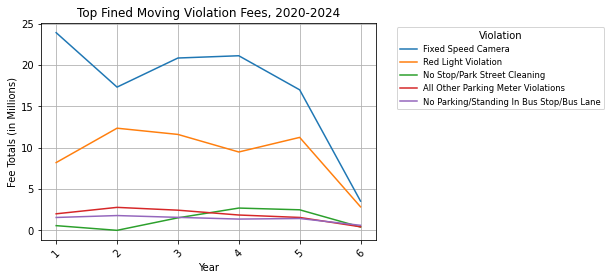

In [ ]:
top_five = ['Fixed Speed Camera', 'Red Light Violation', 'No Stop/Park Street Cleaning', 'All Other Parking Meter Violations', 'No Parking/Standing In Bus Stop/Bus Lane']
#df_paid.set_index('Year', inplace=True)
ax = (df_paid[top_five] / 1000000).plot(title='Top Fined Moving Violation Fees, 2020-2024', legend=False)
ax.set_xlabel('Year')
ax.set_ylabel('Fee Totals (in Millions)')
ax.legend(title='Violation', fontsize='small', title_fontsize='medium', bbox_to_anchor=(1.05, 1), loc='upper left')
ax.grid(True)
plt.xticks(rotation=45)
plt.show()

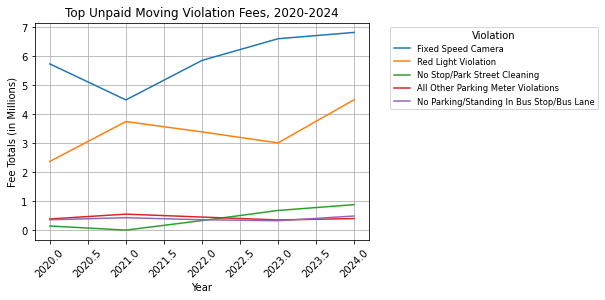

In [ ]:
top_five = ['Fixed Speed Camera', 'Red Light Violation', 'No Stop/Park Street Cleaning', 'All Other Parking Meter Violations', 'No Parking/Standing In Bus Stop/Bus Lane']
df_unpaid.set_index('Year', inplace=True)
ax = (df_unpaid[top_five].drop(2025.0) / 1000000).plot(title='Top Unpaid Moving Violation Fees, 2020-2024', legend=False)
ax.set_xlabel('Year')
ax.set_ylabel('Fee Totals (in Millions)')
ax.legend(title='Violation', fontsize='small', title_fontsize='medium', bbox_to_anchor=(1.05, 1), loc='upper left')
ax.grid(True)
plt.xticks(rotation=45)
plt.show()

In [ ]:
sum_penalty_neigh_df = joined_df.groupBy(year("ViolDate").alias("Year")) \
    .pivot("Neighborhood") \
    .agg(
    _sum("ViolFine").alias("TotalViolFine"),
#    _sum("Balance").alias("TotalBalance"),
#    _sum("OpenFine").alias("TotalOpenFine"),
#    _sum("OpenPenalty").alias("TotalOpenPenalty")
).sort(asc("Year"))

display(sum_penalty_neigh_df)

Year,null,Abell,Allendale,Arcadia,Arlington,Armistead Gardens,Ashburton,Auchentoroly-Parkwood,Baltimore Highlands,Baltimore Peninsula,Barclay,Barre Circle,Bayview,Beechfield,Belair-Edison,Belair-Parkside,Bellona-Gittings,Belvedere,Berea,Better Waverly,Beverly Hills,Biddle Street,Blythewood,Bolton Hill,Boyd-Booth,Brewers Hill,Bridgeview/Greenlawn,Broadway East,Broening Manor,Brooklyn,Burleith-Leighton,Butcher's Hill,Butchers Hill,CARE,Callaway-Garrison,Cameron Village,Canton,Canton Industrial Area,Carroll - Camden Industrial Area,Carroll Park,Carroll-South Hilton,Carrollton Ridge,Cedarcroft,Cedmont,Cedonia,Central Forest Park,Central Park Heights,Charles North,Charles Village,Cherry Hill,Cheswolde,Chinquapin Park,Clifton Park,Coldspring,Coldstream Homestead Montebello,Concerned Citizens Of Forest Park,Concerned Citizens of Forest Park,Coppin Heights/Ash-Co-East,Cross Country,Cross Keys,Curtis Bay,Curtis Bay Industrial Area,Cylburn,Darley Park,Dickeyville,Dolfield,Dorchester,Downtown,Downtown West,Druid Heights,Druid Hill Park,Dunbar-Broadway,Dundalk Marine Terminal,East Arlington,East Baltimore Midway,Easterwood,Eastwood,Edgewood,Edmondson Village,Ednor Gardens-Lakeside,Ellwood Park/Monument,Evergreen,Evergreen Lawn,Evesham Park,Fairfield Area,Fairmont,Fairmount,Fallstaff,Federal Hill,Fells Point,Forest Park,Forest Park Golf Course,Four By Four,Frankford,Franklin Square,Franklintown,Franklintown Road,Garwyn Oaks,Gay Street,Glen,Glen Oaks,Glenham-Belhar,Graceland Park,Greektown,Greenmount Cemetery,Greenmount West,Greenspring,Grove Park,Guilford,Gwynns Falls,Gwynns Falls/Leakin Park,Hamilton,Hamilton Hills,Hampden,Hanlon-Longwood,Harbor East,Harbor Point,Harlem Park,Harwood,Hawkins Point,Heritage Crossing,Herring Run Park,Highlandtown,Hillen,Hoes Heights,Holabird Industrial Park,Hollins Market,Homeland,Hopkins Bayview,Howard Park,Hunting Ridge,Idlewood,Inner Harbor,Irvington,Johns Hopkins Homewood,Johnston Square,Jones Falls Area,Jonestown,Kenilworth Park,Kernewood,Keswick,Key Highway,Kresson,Lake Evesham,Lake Walker,Lakeland,Langston Hughes,Lauraville,Levindale,Liberty Square,Little Italy,Loch Raven,Locust Point,Locust Point Industrial Area,Lower Edmondson Village,Lower Herring Run Park,Loyola/Notre Dame,Lucille Park,Madison Park,Madison-Eastend,Mayfield,McElderry Park,Medfield,Medford,Mid-Govans,Mid-Town Belvedere,Middle Branch/Reedbird Parks,Middle East,Midtown-Edmondson,Millhill,Milton-Montford,Mondawmin,Montebello,Moravia-Walther,Morgan Park,Morgan State University,Morrell Park,Mosher,Mount Clare,Mount Holly,Mount Vernon,Mount Washington,Mount Winans,Mt Pleasant Park,New Northwood,New Southwest/Mount Clare,North Harford Road,North Roland Park/Poplar Hill,Northwest Community Action,O'Donnell Heights,Oakenshawe,Oaklee,Old Goucher,Oldtown,Oliver,Orangeville,Orangeville Industrial Area,Orchard Ridge,Original Northwood,Otterbein,Overlea,Panway/Braddish Avenue,Park Circle,Parklane,Parkside,Parkview/Woodbrook,Parkway,Patterson Park,Patterson Park Neighborhood,Patterson Place,Pen Lucy,Penn North,Penn-Fallsway,Penrose/Fayette Street Outreach,Perkins,Perkins Homes,Perring Loch,Pimlico Good Neighbors,Pleasant View Gardens,Poppleton,Port Covington,Pulaski Industrial Area,Purnell,Radnor-Winston,Ramblewood,Reisterstown Station,Remington,Reservoir Hill,Richnor Springs,Ridgely's Delight,Riverside,Rognel Heights,Roland Park,Rosebank,Rosemont,Rosemont East,Rosemont Homeowners/Tenants,Sabina-Mattfeldt,Saint Agnes,Saint Helena,Saint Josephs,Saint Paul,Sandtown-Winchester,Seton Business Park,Seton Hill,Sharp-Leadenhall,Shipley Hill,South Baltimore,South Clifton Park,Spring Garden Industrial Area,Stadium/Entertainment Area,Stonewood-Pentwood-Winston,Taylor Heights,Ten Hills,The Orchards,Towanda-Grantley,Tremont,Tuscany-Canterbury,Union Square,University Of Maryland,University of Maryland,Uplands,Upper Fells Point,Upton,Villages of Homeland,Violetville,Wakefield,Walbrook,Waltherson,Washington Hill,Washington Village/Pigtown,Waverly,West Arlington,

In [ ]:
#Fixed Speed Camera
speed_camera_df = joined_df.filter(col("Description") == "Fixed Speed Camera").groupBy("Address").sum("ViolFine",'OpenFine', 'OpenPenalty', "Balance")

speed_camera_df = speed_camera_df.withColumn("RevenueCollected", col("sum(violFine)") - col("sum(OpenFine)"))

speed_camera_df = speed_camera_df.withColumn("PctNotPaid", 100*col("sum(OpenFine)") / col("sum(violFine)")).sort(desc("PctNotPaid"))

speed_camera_pd_df = speed_camera_df.toPandas()

display(speed_camera_df)

Address,sum(ViolFine),sum(OpenFine),sum(OpenPenalty),sum(Balance),RevenueCollected,PctNotPaid
E/S 3300 POWHATAN AVE,40,40,0,40,0,100.0
4800 BLK WALTHER AVE NB,840,800,0,800,40,95.23809523809524
5201 HILLEN RD NB,2760,2560,0,2560,200,92.7536231884058
5257 HILLEN RD SB,6000,5320,0,5320,680,88.66666666666667
3900 BLK BELAIR RD NB,40880,29420,0,29450,11460,71.96673189823875
4800 BLK WALTHER AVE SB,7520,5120,0,5120,2400,68.08510638297872
3400 BLK HILLSDALE RD SB,3960,2600,0,2600,1360,65.65656565656566
3900 BLK BELAIR RD SB,38280,25040,0,25040,13240,65.41274817136886
2800 BLK THE ALAMEDA NB,31840,18400,0,18400,13440,57.78894472361809
6231 BELAIR RD / US 1 SB,51680,29580,0,29580,22100,57.23684210526316


In [ ]:
high_speeders_2024 = df_2024.filter(col("Description")=="Fixed Speed Camera").groupBy("Tag").count().sort(desc("count")).toPandas()

#df_2024.filter(col("Description")=="Fixed Speed Camera").groupBy("Tag").count().sort(desc("count")).show()

high_speeders_2024

,Tag,count
0,5FC3825,135
1,TLL7892,105
2,TNP4899,105
3,TJS1225,103
4,TLU2188,88
...,...,...
217882,4CP9521,1
217883,7GB2329,1
217884,7CJ2684,1
217885,2GL7310,1


# Total Speed Camera Violation Fines by State

In [ ]:
jdf_sums_state = joined_df.groupby('State').agg(
    _sum("ViolFine").alias("TotalViolFine"),
    _sum("Balance").alias("TotalBalance"),
    _sum("OpenFine").alias("TotalOpenFine"),
    _sum("OpenPenalty").alias("TotalOpenPenalty")
)

jdf_sums_state = jdf_sums_state.withColumn("Paid", col("TotalViolFine") - col("TotalOpenFine"))

jdf_sums_state = jdf_sums_state.withColumn("PercentPaid", col("Paid") / col("TotalViolFine"))

df_sums_state = jdf_sums_state.toPandas()

In [ ]:
#Filter out small infracting states
df_sums_state = df_sums_state[df_sums_state['TotalViolFine']>10000]


df_sums_state.sort_values('PercentPaid', ascending=False)

,State,TotalViolFine,TotalBalance,TotalOpenFine,TotalOpenPenalty,Paid,PercentPaid
16,RI,54614,16936,10291,4765,44323,0.811568
60,MA,463661,152247,92206,45504,371455,0.801135
53,NY,1815340,732291,420900,218799,1394440,0.768143
31,MD,235460701,86573320,57253836,24428110,178206865,0.756843
26,CT,449218,172574,120959,33695,328259,0.730734
20,MI,282309,131129,79007,41522,203302,0.720140
19,NH,59380,19299,17219,0,42161,0.710020
48,NM,37902,16951,11304,4157,26598,0.701757
7,NJ,2447762,1073601,732002,239512,1715760,0.700951
17,KY,109295,51450,32858,14512,76437,0.699364


Thank you to Rhode Island, Massachusetts, and New York for paying your fines

In [ ]:
df_sums_state[df_sums_state["State"] == "VA"]

,State,TotalViolFine,TotalBalance,TotalOpenFine,TotalOpenPenalty,Paid,PercentPaid
14,VA,18858707,17772262,12582710,3942450,6275997,0.33279


## Virginian cars made up \$ 18 million dollars in fees over the last 5 Years, but only paid 6.2 Million dollars of those fees; Only one third of all fines assessed. This was the second lowest out of all states that were assessed 100,000+ in fines over this time period

In [ ]:
jdf_sums_va = joined_df.filter(col('State') == "VA").groupby(year("ViolDate").alias("Year")).agg(
    _sum("ViolFine").alias("TotalViolFine"),
    _sum("Balance").alias("TotalBalance"),
    _sum("OpenFine").alias("TotalOpenFine"),
    _sum("OpenPenalty").alias("TotalOpenPenalty")
).sort(asc("Year"))
jdf_sums_va = jdf_sums_va.withColumn("Paid", col("TotalViolFine") - col("TotalOpenFine"))

jdf_sums_va = jdf_sums_va.withColumn("PercentPaid", 100 * col("Paid") / col("TotalViolFine"))



display(jdf_sums_va)
df_sums_va = jdf_sums_va.toPandas()

Year,TotalViolFine,TotalBalance,TotalOpenFine,TotalOpenPenalty,Paid,PercentPaid
2020,2167771,1844201,1486488,349392,681283,31.42781225507676
2021,2457710,2186363,1630913,530098,826797,33.64095031553764
2022,3263417,3156925,1946238,968474,1317179,40.361958033558075
2023,4672722,4658039,2938859,1281449,1733863,37.10605938037829
2024,4952912,4738412,3491189,808989,1461723,29.512395940004588
2025,1344175,1188322,1089023,4048,255152,18.982052188145143


In [ ]:
df_sums_va["Unpaid"] = df_sums_va["TotalOpenFine"]

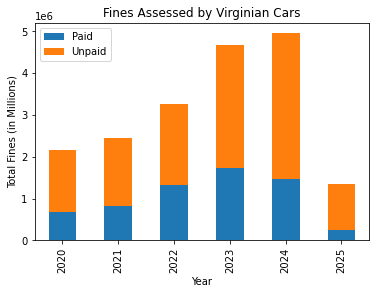

In [ ]:
df_sums_va["Unpaid"] = df_sums_va["TotalOpenFine"]

ax = df_sums_va.sort_values('Year').set_index('Year')[['Paid', 'Unpaid']].plot(kind='bar', stacked=True)

plt.xlabel('Year')
plt.ylabel('Total Fines (in Millions)')
plt.title('Fines Assessed by Virginian Cars')
plt.show()

#ax.get_figure().savefig('Graphs/Total Fines Paid Unpaid 2020-2025.png')

In [ ]:
jdf_2024_sums_neigh = joined_df.groupby('Neighborhood').agg(
    _sum("ViolFine").alias("TotalViolFine"),
    _sum("Balance").alias("TotalBalance"),
    _sum("OpenFine").alias("TotalOpenFine"),
    _sum("OpenPenalty").alias("TotalOpenPenalty")
)

jdf_2024_sums_neigh = jdf_2024_sums_neigh.withColumn("PctNotPaid", 100*col("TotalOpenFine") / col("TotalViolFine")).sort(desc("PctNotPaid"))

jdf_2024_sums_neigh = jdf_2024_sums_neigh.withColumn("TotalPaid", col("TotalViolFine") - col("TotalOpenFine"))

#Create a pandas df for graphing
df_2024_sums_neigh = jdf_2024_sums_neigh.toPandas()

display(jdf_2024_sums_neigh)

Neighborhood,TotalViolFine,TotalBalance,TotalOpenFine,TotalOpenPenalty,PctNotPaid,TotalPaid
Curtis Bay Industrial Area,5436,11374,5070,6304,93.26710816777042,366
Middle Branch/Reedbird Parks,981,1410,802,608,81.75331294597349,179
Greenmount Cemetery,1400,2492,1052,1440,75.14285714285714,348
Langston Hughes,36149,54510,26700,27810,73.86096434202882,9449
Orangeville Industrial Area,14991,38018,11029,25689,73.57080915215796,3962
Wrenlane,7835,11423,5565,5858,71.02744097000638,2270
Windsor Hills,26476,35066,18289,16777,69.07765523492975,8187
Moravia-Walther,11273,16226,7727,7849,68.54430941186907,3546
Boyd-Booth,19965,27824,13443,14381,67.3328324567994,6522
Grove Park,39221,43383,26119,16614,66.59442645521531,13102


In [ ]:
df_2024_sums_neigh

,Neighborhood,TotalViolFine,TotalBalance,TotalOpenFine,TotalOpenPenalty,PctNotPaid,TotalPaid
0,Curtis Bay Industrial Area,5436,11374,5070,6304,93.267108,366
1,Middle Branch/Reedbird Parks,981,1410,802,608,81.753313,179
2,Greenmount Cemetery,1400,2492,1052,1440,75.142857,348
3,Langston Hughes,36149,54510,26700,27810,73.860964,9449
4,Orangeville Industrial Area,14991,38018,11029,25689,73.570809,3962
...,...,...,...,...,...,...,...
287,Key Highway,128,0,0,0,0.000000,128
288,Port Covington,109,0,0,0,0.000000,109
289,Dundalk Marine Terminal,32,0,0,0,0.000000,32
290,Fairmont,302,0,0,0,0.000000,302


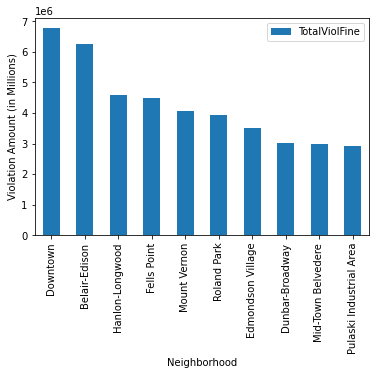

In [ ]:
df_2024_sums_neigh= df_2024_sums_neigh[df_2024_sums_neigh['TotalViolFine'] > 100000].dropna().sort_values(by='TotalViolFine', ascending=False)
df_2024_sums_neigh[:10].plot(x='Neighborhood', y='TotalViolFine', kind='bar')
plt.xlabel('Neighborhood')
plt.ylabel('Violation Amount (in Millions)')
plt.show()



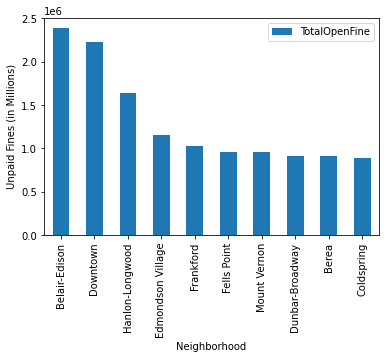

In [ ]:
df_2024_sums_neigh.sort_values(by='TotalOpenFine', ascending=False)[:10].plot(x='Neighborhood', y='TotalOpenFine', kind='bar')
plt.xlabel('Neighborhood')
plt.ylabel('Unpaid Fines (in Millions)')
plt.show()

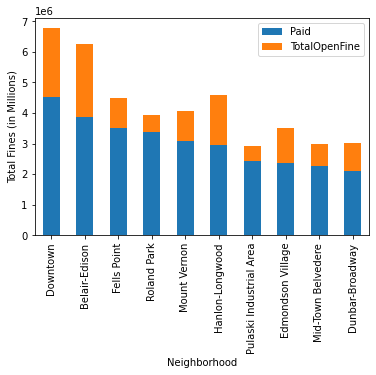

In [ ]:
df_2024_sums_neigh = df_2024_sums_neigh.set_index('Neighborhood')

df_2024_sums_neigh['Paid'] = df_2024_sums_neigh['TotalViolFine'] - df_2024_sums_neigh['TotalOpenFine']

df_2024_sums_neigh[['Paid', 'TotalOpenFine']].sort_values(by='Paid', ascending=False)[:10].plot(kind='bar', stacked=True)
plt.xlabel('Neighborhood')
plt.ylabel('Total Fines (in Millions)')
plt.show()

In [ ]:
df_2024_sums = df_2024.groupby('Description').sum("ViolFine",'OpenFine', 'OpenPenalty', "Balance").sort(desc("sum(ViolFine)"))
display(df_2024_sums)

Description,sum(ViolFine),sum(OpenFine),sum(OpenPenalty),sum(Balance)
Fixed Speed Camera,16984400,6819690,0,6823766
Red Light Violation,11235300,4499146,0,4501225
Interstate 83,6837680,0,0,2265361
No Stop/Park Street Cleaning,2484248,879540,1303186,2220989
All Other Parking Meter Violations,1560384,399024,945087,1356240
No Parking/Standing In Bus Stop/Bus Lane,1433628,487222,135230,623105
No Stopping/Standing Tow Away Zone,1335516,439162,634487,1087750
No Stopping/Standing Not Tow-Away Zone,927168,255410,601418,866977
Residential Parking Permit Only,896636,189570,287174,478914
Abandonded Vehicle,816608,640750,146472,788177


In [ ]:
df_2024_state_sums = df_2024.filter(col("Description")=="Fixed Speed Camera").groupBy("State").sum("ViolFine",'OpenFine', 'OpenPenalty', "Balance").sort(desc("sum(ViolFine)"))
display(df_2024_state_sums)

State,sum(ViolFine),sum(OpenFine),sum(OpenPenalty),sum(Balance)
MD,13791080,4487318,0,4490662
VA,1930320,1660212,0,1660944
PA,380760,205080,0,205080
NJ,134840,56720,0,56720
NY,92560,35680,0,35680
FL,90600,47960,0,47960
NC,87680,56920,0,56920
DE,68480,35800,0,35800
TX,44880,28960,0,28960
GA,44280,27320,0,27320


# Unpaid Violation amounts by State

In [ ]:
df_2024_desc_state_sums = df_2024.groupBy("State", "Description").sum("ViolFine",'OpenFine', 'OpenPenalty', "Balance").sort(desc("sum(Balance)"))
display(df_2024_desc_state_sums)

State,Description,sum(ViolFine),sum(OpenFine),sum(OpenPenalty),sum(Balance)
MD,Fixed Speed Camera,13791080,4487318,0,4490662
MD,Red Light Violation,9434325,3215193,0,3216800
VA,Fixed Speed Camera,1930320,1660212,0,1660944
MD,No Stop/Park Street Cleaning,1864460,542086,979533,1533732
MD,Interstate 83,5071840,0,0,1411213
MD,Expired Tags,644512,312508,713730,1034386
MD,All Other Parking Meter Violations,1215744,258610,739043,1002682
VA,Red Light Violation,1117125,919247,0,919644
MD,No Stopping/Standing Tow Away Zone,973544,265360,472770,743227
MD,No Stopping/Standing Not Tow-Away Zone,713184,163453,459780,628404


In [ ]:
df_2024.groupBy("Description").count().sort(desc("count")).show(40, False)

+---------------------------------------------------------------+------+
|Description                                                    |count |
+---------------------------------------------------------------+------+
|Fixed Speed Camera                                             |424610|
|Interstate 83                                                  |170942|
|Red Light Violation                                            |149804|
|All Other Parking Meter Violations                             |48762 |
|No Stop/Park Street Cleaning                                   |47774 |
|No Stopping/Standing Not Tow-Away Zone                         |28974 |
|No Stopping/Standing Tow Away Zone                             |25683 |
|Expired Tags                                                   |22269 |
|Residential Parking Permit Only                                |17243 |
|All Other Stopping or Parking Violations                       |7412  |
|No Stopping//Parking Stadium Event Camden         

In [ ]:
df.show(10, False)

+---------+-------+-----+-----+-----+-----+------------------------+--------+--------------------------------------+--------+-------------------+-------+-----------+--------+-----------+-------------------+-------------------+-----------+-------------+--------------+-------------------+------------+--------------+---------------+---------------------------+------------------+
|Citation |Tag    |ExpMM|ExpYY|State|Make |Address                 |ViolCode|Description                           |ViolFine|ViolDate           |Balance|PenaltyDate|OpenFine|OpenPenalty|NoticeDate         |InvestigationStatus|TrialStatus|GeneralStatus|GroupID       |ImportDate         |Neighborhood|PoliceDistrict|CouncilDistrict|Location                   |CleanedAddress    |
+---------+-------+-----+-----+-----+-----+------------------------+--------+--------------------------------------+--------+-------------------+-------+-----------+--------+-----------+-------------------+-------------------+-----------+----

In [ ]:
from pyspark.sql.functions import hour, col
df.where(df.State == "VA").groupby(['Tag', 'State']).count().orderBy(col('count').desc()).show()

+-------+-----+-----+
|    Tag|State|count|
+-------+-----+-----+
|UDS4055|   VA|  470|
|TWX9432|   VA|  408|
|TPT5521|   VA|  198|
|TLL7892|   VA|  182|
|TNP4899|   VA|  175|
|TNL6078|   VA|  136|
|USF5510|   VA|  136|
|TUT2095|   VA|  127|
|TSS4212|   VA|  125|
|REAPER9|   VA|  125|
|TXK7743|   VA|  121|
|TTK8250|   VA|  119|
| 3497FX|   VA|  118|
|UFU8195|   VA|  115|
|TTP2353|   VA|  115|
|TJS1225|   VA|  115|
|URE8395|   VA|  114|
|UCB4156|   VA|  113|
|UPV1119|   VA|  112|
|UHA5830|   VA|  111|
+-------+-----+-----+
only showing top 20 rows



In [ ]:
df.select(['Tag', 'Balance', 'OpenFine', 'OpenPenalty', 'NoticeDate','State', 'Address']).where(df.Tag == 'REAPER9').show()

#UDS4055
#A360993

+-------+-------+--------+-----------+----------+-----+--------------------+
|    Tag|Balance|OpenFine|OpenPenalty|NoticeDate|State|             Address|
+-------+-------+--------+-----------+----------+-----+--------------------+
|REAPER9|     40|      40|          0|      null|   VA|4400 BLK LIBERTY ...|
|REAPER9|     40|      40|          0|      null|   VA|200 BLK MONROE ST...|
|REAPER9|     40|      40|          0|      null|   VA|4400 BLK LIBERTY ...|
|REAPER9|     40|      40|          0|      null|   VA|4400 BLK EDMONDSO...|
|REAPER9|     40|      40|          0|      null|   VA|4000 BLK THE ALAM...|
|REAPER9|     40|      40|          0|      null|   VA|1300 BLK W FRANKL...|
|REAPER9|     40|      40|          0|      null|   VA|2400 BLK BELAIR R...|
|REAPER9|     40|      40|          0|      null|   VA|2400 BLK BELAIR R...|
|REAPER9|     40|      40|          0|      null|   VA|1100 BLK DRUID HI...|
|REAPER9|     40|      40|          0|      null|   VA|2500 BLK HARFORD ...|

In [ ]:
df.show(10, truncate=False)

+---------+-------+-----+-----+-----+-----+------------------------+--------+--------------------------------------+--------+-------------------+-------+-----------+--------+-----------+-------------------+-------------------+-----------+-------------+--------------+-------------------+------------+--------------+---------------+---------------------------+------------------+
|Citation |Tag    |ExpMM|ExpYY|State|Make |Address                 |ViolCode|Description                           |ViolFine|ViolDate           |Balance|PenaltyDate|OpenFine|OpenPenalty|NoticeDate         |InvestigationStatus|TrialStatus|GeneralStatus|GroupID       |ImportDate         |Neighborhood|PoliceDistrict|CouncilDistrict|Location                   |CleanedAddress    |
+---------+-------+-----+-----+-----+-----+------------------------+--------+--------------------------------------+--------+-------------------+-------+-----------+--------+-----------+-------------------+-------------------+-----------+----

In [ ]:
df.schema

Out[55]: StructType([StructField('Citation', StringType(), True), StructField('Tag', StringType(), True), StructField('ExpMM', StringType(), True), StructField('ExpYY', StringType(), True), StructField('State', StringType(), True), StructField('Make', StringType(), True), StructField('Address', StringType(), True), StructField('ViolCode', StringType(), True), StructField('Description', StringType(), True), StructField('ViolFine', IntegerType(), True), StructField('ViolDate', TimestampType(), True), StructField('Balance', IntegerType(), True), StructField('PenaltyDate', TimestampType(), True), StructField('OpenFine', IntegerType(), True), StructField('OpenPenalty', IntegerType(), True), StructField('NoticeDate', TimestampType(), True), StructField('InvestigationStatus', StringType(), True), StructField('TrialStatus', StringType(), True), StructField('GeneralStatus', StringType(), True), StructField('GroupID', StringType(), True), StructField('ImportDate', TimestampType(), True), StructF

In [ ]:
df.select("CleanedAddress").show(50)

+--------------------+
|      CleanedAddress|
+--------------------+
|  400 E BALTIMORE ST|
|         400 BALT ST|
|    300 BALTIMORE ST|
|     300 E BALTIMORE|
|    300 BALTIMORE ST|
|    300 BALTIMORE ST|
|  200 E BALTIMORE ST|
|    300 BALTIMORE ST|
|        400 WATER ST|
|         17 LIGHT ST|
|1000 PENNSYLVANIA...|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|300 WEST BALTIMOR...|
|   30 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|       15 S EUTAW ST|
|       15 S EUTAW ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|     000 COMMERCE ST|
|     000 COMMERCE ST|
|   400 W MULBERRY ST|
|  300 W BALTIMORE ST|
|  300 W BALTIMORE ST|
|        300 WATER ST|
|        300 WATER ST|
|    300 N CHARLES ST|
|    300 N CHARLES ST|
|    300 N CHARLES ST|
|   300 W SARATOGA ST|
|  300 W LEXINGTON ST|
|    300 W FAYETTE ST|
|      100 N EUTAW ST|
|   300 W SARATOGA ST|
|  300 W. SARATOGA ST|
|   300 W SARATOGA ST|
|    300 W 

In [ ]:
from pyspark.sql.functions import lit
df.select("Address").filter(df['ViolDate'] > lit("2022-01-01")).distinct().count()

Out[57]: 40846